In [1]:
!pip install plotly
from sklearn.cluster import KMeans
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from matplotlib import pyplot as plt

In [2]:
df=pd.read_csv("train.csv")
df.head()

,Dates,Category,Descript,DayOfWeek,PdDistrict,Resolution,Address,X,Y
0,2015-05-13 23:53:00,WARRANTS,WARRANT ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",OAK ST / LAGUNA ST,-122.425892,37.774599
1,2015-05-13 23:53:00,OTHER OFFENSES,TRAFFIC VIOLATION ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",OAK ST / LAGUNA ST,-122.425892,37.774599
2,2015-05-13 23:33:00,OTHER OFFENSES,TRAFFIC VIOLATION ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",VANNESS AV / GREENWICH ST,-122.424363,37.800414
3,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,NORTHERN,NONE,1500 Block of LOMBARD ST,-122.426995,37.800873
4,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,PARK,NONE,100 Block of BRODERICK ST,-122.438738,37.771541


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 878049 entries, 0 to 878048
Data columns (total 9 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   Dates       878049 non-null  object 
 1   Category    878049 non-null  object 
 2   Descript    878049 non-null  object 
 3   DayOfWeek   878049 non-null  object 
 4   PdDistrict  878049 non-null  object 
 5   Resolution  878049 non-null  object 
 6   Address     878049 non-null  object 
 7   X           878049 non-null  float64
 8   Y           878049 non-null  float64
dtypes: float64(2), object(7)
memory usage: 60.3+ MB


In [4]:
df=df.drop(["PdDistrict","Address","Resolution","Descript","DayOfWeek"],axis=1)

In [5]:
df.head()

,Dates,Category,X,Y
0,2015-05-13 23:53:00,WARRANTS,-122.425892,37.774599
1,2015-05-13 23:53:00,OTHER OFFENSES,-122.425892,37.774599
2,2015-05-13 23:33:00,OTHER OFFENSES,-122.424363,37.800414
3,2015-05-13 23:30:00,LARCENY/THEFT,-122.426995,37.800873
4,2015-05-13 23:30:00,LARCENY/THEFT,-122.438738,37.771541


In [6]:
df.tail()

,Dates,Category,X,Y
878044,2003-01-06 00:15:00,ROBBERY,-122.459033,37.714056
878045,2003-01-06 00:01:00,LARCENY/THEFT,-122.447364,37.731948
878046,2003-01-06 00:01:00,LARCENY/THEFT,-122.403390,37.780266
878047,2003-01-06 00:01:00,VANDALISM,-122.390531,37.780607
878048,2003-01-06 00:01:00,FORGERY/COUNTERFEITING,-122.394926,37.738212


In [7]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
X,878049.0,-122.422616,0.030354,-122.513642,-122.432952,-122.416420,-122.406959,-120.5
Y,878049.0,37.771020,0.456893,37.707879,37.752427,37.775421,37.784369,90.0


In [8]:
df.isnull().sum()

Dates       0
Category    0
X           0
Y           0
dtype: int64

In [9]:
f=lambda x:(x["Dates"].split())[0]
df["Dates"]=df.apply(f,axis=1)

In [10]:
df.head()

,Dates,Category,X,Y
0,2015-05-13,WARRANTS,-122.425892,37.774599
1,2015-05-13,OTHER OFFENSES,-122.425892,37.774599
2,2015-05-13,OTHER OFFENSES,-122.424363,37.800414
3,2015-05-13,LARCENY/THEFT,-122.426995,37.800873
4,2015-05-13,LARCENY/THEFT,-122.438738,37.771541


In [11]:
f=lambda x:(x["Dates"].split("-"))[0]
df["Dates"]=df.apply(f,axis=1)

In [12]:
df.tail()

,Dates,Category,X,Y
878044,2003,ROBBERY,-122.459033,37.714056
878045,2003,LARCENY/THEFT,-122.447364,37.731948
878046,2003,LARCENY/THEFT,-122.403390,37.780266
878047,2003,VANDALISM,-122.390531,37.780607
878048,2003,FORGERY/COUNTERFEITING,-122.394926,37.738212


In [13]:
df_2014=df[(df["Dates"]=="2014")]

In [14]:
len(df_2014)

74766

In [15]:
df_2014.tail()

,Dates,Category,X,Y
102345,2014,OTHER OFFENSES,-122.387235,37.719401
102346,2014,WARRANTS,-122.387235,37.719401
102347,2014,FRAUD,-122.418382,37.783258
102348,2014,NON-CRIMINAL,-122.413652,37.728320
102349,2014,FRAUD,-122.408563,37.797007


In [16]:
scaler=MinMaxScaler()
scaler.fit(df_2014[["X"]])
df_2014["X_scaled"]=scaler.transform(df_2014[["X"]])
scaler.fit(df_2014[["X"]])
df_2014["Y_scaled"]=scaler.transform(df_2014[["Y"]])

<ipython-input-16-f64964761df3>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2014["X_scaled"]=scaler.transform(df_2014[["X"]])
<ipython-input-16-f64964761df3>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2014["Y_scaled"]=scaler.transform(df_2014[["Y"]])


In [17]:
df_2014.head()

,Dates,Category,X,Y,X_scaled,Y_scaled
27584,2014,LARCENY/THEFT,-122.435563,37.760801,0.526134,1080.006707
27585,2014,LARCENY/THEFT,-122.433575,37.800037,0.539528,1080.271101
27586,2014,VEHICLE THEFT,-122.412777,37.786834,0.679676,1080.182132
27587,2014,ASSAULT,-122.421702,37.773641,0.619540,1080.093230
27588,2014,ASSAULT,-122.421702,37.773641,0.619540,1080.093230


In [18]:
k_range=range(1,15)
list_dist=[]
for k in k_range:
    model=KMeans(n_clusters=k)
    model.fit(df_2014[["X_scaled","Y_scaled"]])
    list_dist.append(model.inertia_)

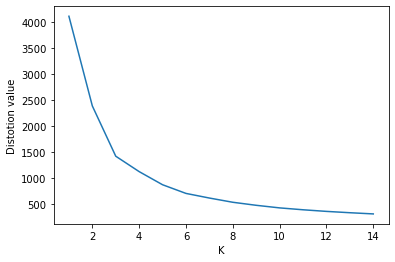

In [19]:
plt.xlabel("K")
plt.ylabel("Distotion value")
plt.plot(k_range,list_dist)
plt.show()

## k=5

In [20]:
model=KMeans(n_clusters=5)
y_pred=model.fit_predict(df_2014[["X_scaled","Y_scaled"]])

In [21]:
df_2014["cluster"]=y_pred

<ipython-input-21-2b61e69416a9>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2014["cluster"]=y_pred


In [22]:
df_2014.head()

,Dates,Category,X,Y,X_scaled,Y_scaled,cluster
27584,2014,LARCENY/THEFT,-122.435563,37.760801,0.526134,1080.006707,2
27585,2014,LARCENY/THEFT,-122.433575,37.800037,0.539528,1080.271101,2
27586,2014,VEHICLE THEFT,-122.412777,37.786834,0.679676,1080.182132,0
27587,2014,ASSAULT,-122.421702,37.773641,0.619540,1080.093230,2
27588,2014,ASSAULT,-122.421702,37.773641,0.619540,1080.093230,2


In [23]:
import plotly.express as px

In [24]:
figure=px.scatter_mapbox(df_2014,lat="Y",lon="X",
                        center=dict(lat=37.8,lon=-122.4),
                         zoom=9,
                         opacity=.9,
                         mapbox_style="stamen-terrain",
                         color="cluster",
                         title="San_Francisco_Crime_Districts",
                         width=1100,
                         height=700,
                         hover_data=["cluster","Category","X","Y"]
                         )
figure.show()

In [25]:
import plotly

In [26]:
plotly.offline.plot(figure,filename="maptest.html",auto_open=True)
help(px.scatter_mapbox)

Help on function scatter_mapbox in module plotly.express._chart_types:

scatter_mapbox(data_frame=None, lat=None, lon=None, color=None, text=None, hover_name=None, hover_data=None, custom_data=None, size=None, animation_frame=None, animation_group=None, category_orders=None, labels=None, color_discrete_sequence=None, color_discrete_map=None, color_continuous_scale=None, range_color=None, color_continuous_midpoint=None, opacity=None, size_max=None, zoom=8, center=None, mapbox_style=None, title=None, template=None, width=None, height=None)
        In a Mapbox scatter plot, each row of `data_frame` is represented by a
        symbol mark on a Mapbox map.
        
    Parameters
    ----------
    data_frame: DataFrame or array-like or dict
        This argument needs to be passed for column names (and not keyword
        names) to be used. Array-like and dict are tranformed internally to a
        pandas DataFrame. Optional: if missing, a DataFrame gets constructed
        under the hood 